# CONTOURS & HIERARCHIES

Here we'll see how to use **OpenCV** functions to find the contours of the objects in an image. 
    
    A contour is a closed curve of points or line segments, representing the boundaries of an object in an image.
    In other words, contours represent the shapes of objects found in an image.
    
If internal detail is visible in an image, the object may produce several associated contours, which are returned in a **hierarchical** data structure. Once we find the contours of the objects in an image, we can do things like: 
* determine the number of objects in an image,
* classify the shapes of the objects, or 
* measure the size of the objects. 

`NOTE 1`: **The input to the contour-finding process is a binary image**, which we will produce by first applying **thresholding** and / or **edge detection**. 
`NOTE 2`: In the binary image, **the objects we wish to detect should be *white***, while the **background of the image should be *black***.

## Edges v/s Contours

The difference between **edges** and **contours** is significant. 

When we perform **edge detection**: we find the points where the intensity of colors changes significantly, and turn those pixels ON, while turning the rest of the pixels OFF. The edge pixels are in an image, and there is no particular requirement that the pixels representing an edge are all contiguous.

**Contours**: not necessarily part of an image, unless we choose to draw them. Rather, contours are abstract collections of points and / or line segments corresponding to the shapes of the objects in the image. Thus, they can be manipulated by our programs: 
* we can count the number of contours
* use them to categorize the shapes in the object
* use them to crop objects from an image, and more. 


## Using contours to count objects

In [1]:
import cv2
from PIL import Image
import numpy as np
import random

In [2]:
image = cv2.imread('./dice.jpg')
image_copy = image.copy()
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (5, 5), 0)
(t, binary) = cv2.threshold(blur,
                            195,
                            255,
                            cv2.THRESH_BINARY)

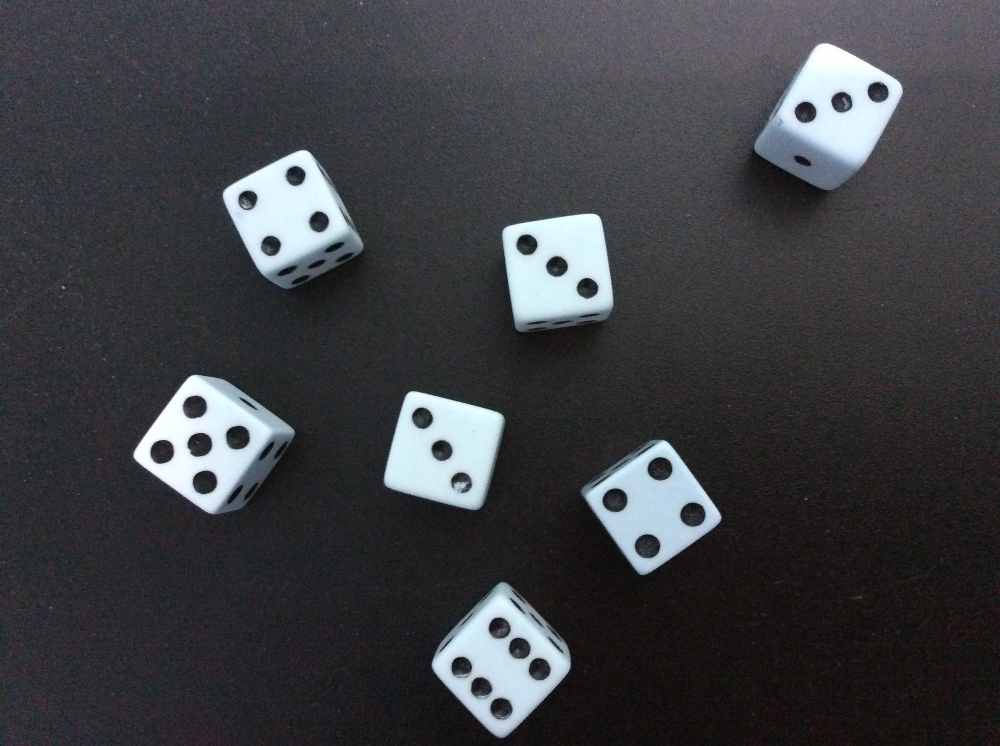

In [3]:
Image.fromarray(image.copy())

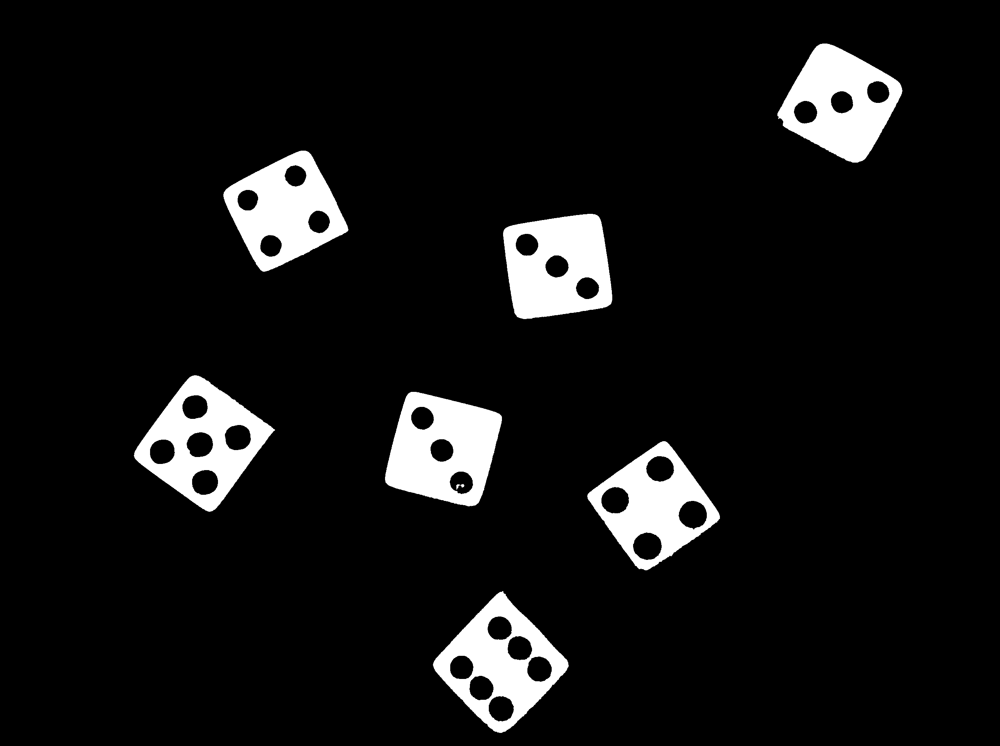

In [4]:
Image.fromarray(binary.copy())

In [5]:
(_, contours, _) = cv2.findContours(binary,
                                    cv2.RETR_EXTERNAL,
                                    cv2.CHAIN_APPROX_SIMPLE)

cv2.drawContours(image,
                contours,
                -1,
                (0, 0, 255),
                5)

array([[[ 63,  63,  77],
        [ 67,  67,  81],
        [ 62,  59,  74],
        ...,
        [103,  95, 105],
        [107, 100, 107],
        [108, 101, 108]],

       [[ 64,  64,  78],
        [ 64,  64,  78],
        [ 60,  57,  72],
        ...,
        [111, 103, 113],
        [114, 106, 116],
        [106, 102, 108]],

       [[ 60,  60,  74],
        [ 66,  66,  80],
        [ 69,  66,  81],
        ...,
        [112, 107, 116],
        [116, 111, 120],
        [106, 103, 112]],

       ...,

       [[ 26,  41,  43],
        [ 25,  40,  42],
        [ 29,  40,  44],
        ...,
        [ 14,  16,  10],
        [ 16,  19,  10],
        [ 19,  22,  13]],

       [[ 21,  36,  38],
        [ 23,  38,  40],
        [ 28,  39,  43],
        ...,
        [ 17,  19,  13],
        [ 20,  23,  14],
        [ 22,  27,  18]],

       [[ 24,  39,  41],
        [ 27,  42,  44],
        [ 33,  44,  48],
        ...,
        [ 16,  18,  12],
        [ 17,  22,  13],
        [ 21,  26,  17]]

In [6]:
# Image.fromarray(image.copy())

In [7]:
print("Found %d objects." % len(contours))
for (i, c) in enumerate(contours):
    print("\tSize of contour %d: %d" % (i, len(c)))

Found 7 objects.
	Size of contour 0: 436
	Size of contour 1: 479
	Size of contour 2: 479
	Size of contour 3: 480
	Size of contour 4: 325
	Size of contour 5: 620
	Size of contour 6: 568


## Understanding Contour Hierarchies

In [8]:
image = cv2.imread('./dice.jpg')
image_copy = image.copy()
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.GaussianBlur(gray, (5, 5), 0)
(t, binary) = cv2.threshold(blur,
                            195,
                            255,
                            cv2.THRESH_BINARY)

In [9]:
(_, contours, hierarchy) = cv2.findContours(binary,
                                           cv2.RETR_TREE,
                                           cv2.CHAIN_APPROX_SIMPLE)

# Count the number of pips on the dice faces
# Iterate through hierarchy[0], first to find the indices of dice contours, then again to find pip contours.

dice = []
pips = []

# find dice contours
for (i, c) in enumerate(hierarchy[0]):
    if c[3] == -1:
        dice.append(i)

# find pip contours
for (i, c) in enumerate(hierarchy[0]):
    if c[3] in dice:
        pips.append(i)

print("Total count of all die rolls: ", len(pips))

Total count of all die rolls:  28


In [10]:
for index, contour in enumerate(contours):
    [x, y, w, h] = cv2.boundingRect(contour)
#     cX = round(int(x + int(w/2)))
#     cY = round(int(y + int(h/2)))
     
#     randomB, randomG, randomR = (random.sample(range(50,255),1)[0],
#                                  random.sample(range(50,255),1)[0],
#                                  random.sample(range(50,255),1)[0]) #returns a list
    
#     randomB, randomG, randomR = (0,
#                                  0,
#                                  0) #returns a list

#     cv2.circle(image_copy,
#                (cX, cY),
#                4,
#                (randomB, randomG, randomR),
#                -1)#4 pixel is radius of circle(dot) and -1 flag means fill the circle with color mentioned
    
    cv2.rectangle(image_copy,
                  (x, y),
                  (x + w, y + h),
                  (0, 100, 255),
                  2)
    
    cv2.putText(image_copy,
                str(index),
                (x+20, y-5),
                cv2.FONT_HERSHEY_SIMPLEX,
                1.25,
                (200, 140, 140),
                3,
                cv2.LINE_AA)


print(hierarchy) # Order: [Next, Previous, First_Child, Parent]
cv2.imwrite("Contours_RETR_TREE.jpg", image_copy)
# print('RETR_TREE')

[[[ 7 -1  1 -1]
  [ 2 -1 -1  0]
  [ 3  1 -1  0]
  [ 4  2 -1  0]
  [ 5  3 -1  0]
  [ 6  4 -1  0]
  [-1  5 -1  0]
  [12  0  8 -1]
  [ 9 -1 -1  7]
  [10  8 -1  7]
  [11  9 -1  7]
  [-1 10 -1  7]
  [17  7 13 -1]
  [15 -1 14 12]
  [-1 -1 -1 13]
  [16 13 -1 12]
  [-1 15 -1 12]
  [23 12 18 -1]
  [19 -1 -1 17]
  [20 18 -1 17]
  [21 19 -1 17]
  [22 20 -1 17]
  [-1 21 -1 17]
  [27 17 24 -1]
  [25 -1 -1 23]
  [26 24 -1 23]
  [-1 25 -1 23]
  [32 23 28 -1]
  [29 -1 -1 27]
  [30 28 -1 27]
  [31 29 -1 27]
  [-1 30 -1 27]
  [-1 27 33 -1]
  [34 -1 -1 32]
  [35 33 -1 32]
  [-1 34 -1 32]]]


True

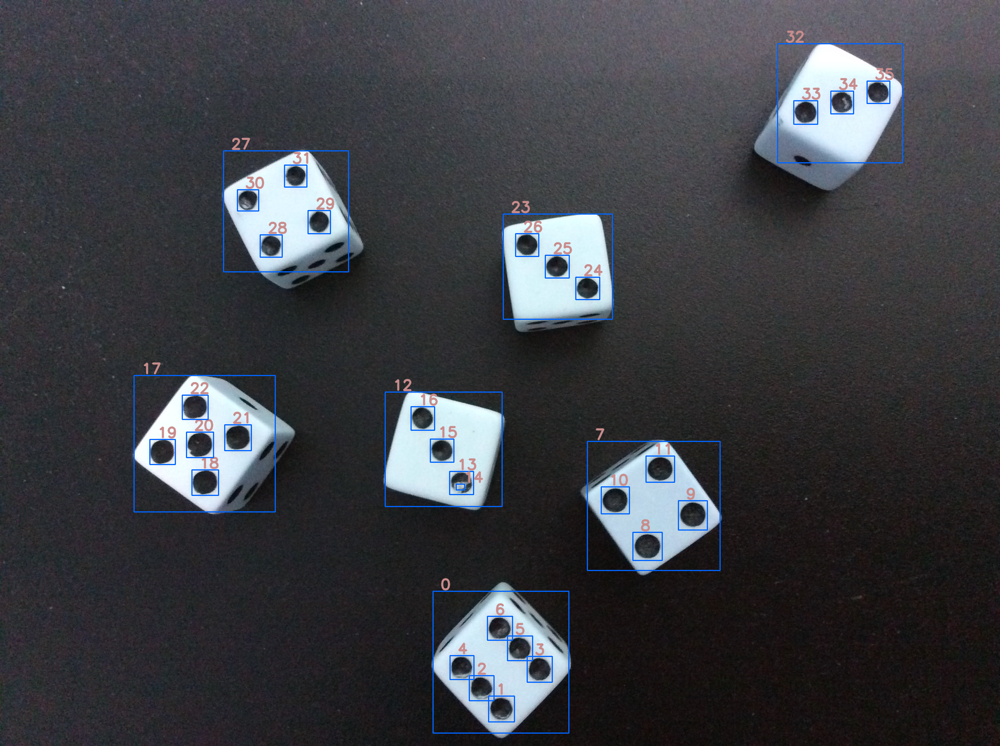

In [11]:
Image.fromarray(image_copy.copy())

In [12]:
img = cv2.imread('./dice.jpg')
img_copy = img.copy()
gry = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gry, (5, 5), 0)
(th, binary_img) = cv2.threshold(blurred,
                            195,
                            255,
                            cv2.THRESH_BINARY)
(_, contours, hierarchy) = cv2.findContours(binary_img,
                                           cv2.RETR_EXTERNAL,
                                           cv2.CHAIN_APPROX_SIMPLE)

for index, contour in enumerate(contours):
    [x, y, w, h] = cv2.boundingRect(contour)
#     cX = round(int(x + int(w/2)))
#     cY = round(int(y + int(h/2)))    
     
#     cv2.circle(img_copy,
#                (cX, cY),
#                4,
#                (0, 0, 255),
#                -1)#4 pixel is radius of circle(dot) and -1 flag means fill the circle with color mentioned
    
    cv2.rectangle(img_copy,
                  (x, y),
                  (x + w, y + h),
                  (0, 100, 255),
                  2)
    
    cv2.putText(img_copy,
                str(index),
                (x+20, y-10),
                cv2.FONT_HERSHEY_SIMPLEX,
                2,
                (200, 140, 140),
                3,
                cv2.LINE_AA)

print(hierarchy) # Order: [Next, Previous, First_Child, Parent]
cv2.imwrite("Contours_RETR_EXTERNAL.jpg", img_copy)
# print("RETR_EXTERNAL")

[[[ 1 -1 -1 -1]
  [ 2  0 -1 -1]
  [ 3  1 -1 -1]
  [ 4  2 -1 -1]
  [ 5  3 -1 -1]
  [ 6  4 -1 -1]
  [-1  5 -1 -1]]]


True

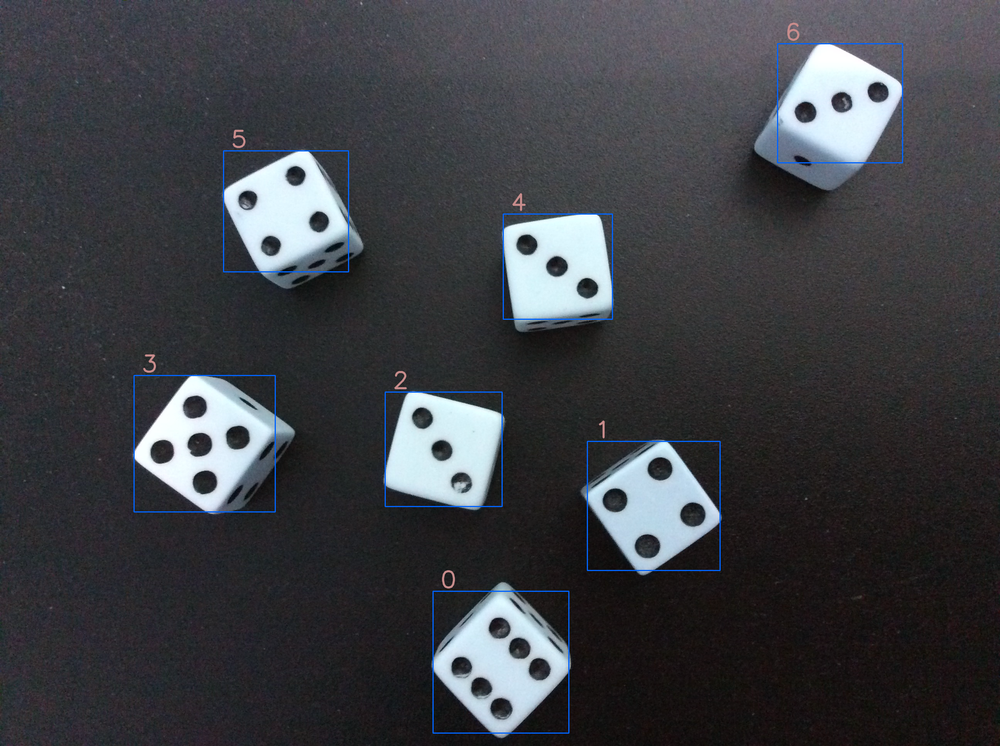

In [13]:
Image.fromarray(img_copy.copy())

## `minAreaRect()` and `boxPoints()`

In [14]:
img = cv2.imread('./dice.jpg')
img_copy = img.copy()
gry = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gry, (5, 5), 0)

(th, binary_img) = cv2.threshold(blurred,
                                 195,
                                 255,
                                 cv2.THRESH_BINARY)

contours = cv2.findContours(binary_img,
                            cv2.RETR_EXTERNAL,
                            cv2.CHAIN_APPROX_SIMPLE)[1]


for index, contour in enumerate(contours):
    rect = cv2.minAreaRect(contour)
    box = cv2.boxPoints(rect) # cv2.boxPoints(rect) for OpenCV 3.x
    box = np.int0(box)
    cv2.drawContours(img, [box], 0, (255, 0, 150), 5)
    [x, y, w, h] = cv2.boundingRect(contour)
    
#     cX = round(int(x + int(w/2)))
#     cY = round(int(y + int(h/2)))         
#     cv2.circle(img,
#                (cX, cY),
#                40,
#                (0, 0, 255),
#                2)#4 pixel is radius of circle(dot) and -1 flag means fill the circle with color mentioned
    
#     cv2.rectangle(img,
#                   (x, y),
#                   (x + w, y + h),
#                   (0, 100, 255),
#                   2)
    
    cv2.putText(img,
                str(index),
                (x+20, y-10),
                cv2.FONT_HERSHEY_SIMPLEX,
                2,
                (200, 140, 140),
                3,
                cv2.LINE_AA)

cv2.imwrite("Contours_minAreaRect.jpg", img)

True

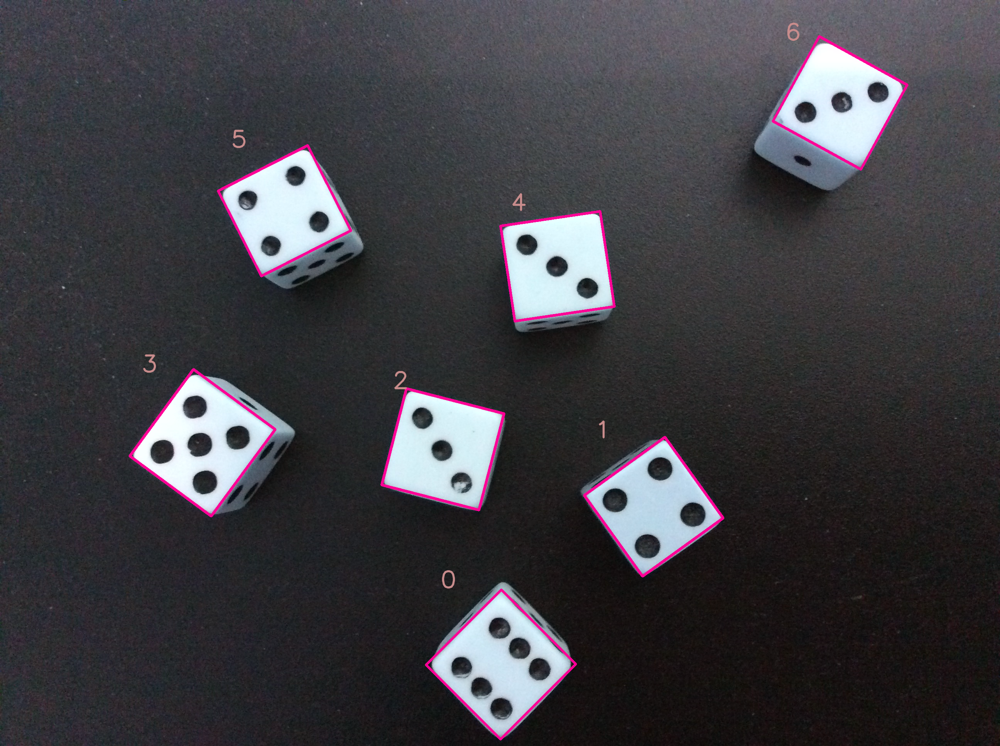

In [15]:
Image.fromarray(img.copy())

In [16]:
# del contours
# del img
# del gry
# del img_copy
# del blurred
# del binary_img
# del hierarchy
# del th
# del t
# del _
# del image
# del gray
# del image_copy
# del blur
# del binary
# del randomB
# del randomG
# del randomR
# del dice
# del pips

`Reference URLs`: [1](https://datacarpentry.org/image-processing/09-contours/), [2](http://snippetnuggets.com/howtos/opencv/tips/remove-children-contours-cv2-findContours-only-parents.html)